Ref: https://github.com/ageron/handson-ml3/blob/main/02_end_to_end_machine_learning_project.ipynb

## 1. Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import csv
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns


In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


In [3]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, r2_score, mean_squared_error, mean_absolute_error, classification_report
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost.sklearn import XGBRegressor
from sklearn.model_selection import GridSearchCV

About this file:
- longitude: A measure of how far west a house is; a higher value is farther west 
- latitude: A measure of how far north a house is; a higher value is farther north
- housingMedianAge: Median age of a house within a block; a lower number is a newer building 
- totalRooms: Total number of rooms within a block
- totalBedrooms: Total number of bedrooms within a block
- population: Total number of people residing within a block
- households: Total number of households, a group of people residing within a home unit, for a block
- medianIncome: Median income for households within a block of houses (measured in tens of thousands of US Dollars) 
- medianHouseValue: Median house value for households within a block (measured in US Dollars)
- oceanProximity: Location of the house w.r.t ocean/sea


## 2. Import the Dataset

In [4]:
data = pd.read_csv('housing.csv')
data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


## 3. ETL

In [5]:
data.dtypes

longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
median_house_value    float64
ocean_proximity        object
dtype: object

In [6]:
data.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [7]:
data[data['total_bedrooms'].isnull()]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
182,-118.27,34.04,13.0,1784.0,NaN,2158.0,682.0,1.7038,118100.0,<1H OCEAN
327,-117.65,34.04,15.0,3393.0,NaN,2039.0,611.0,3.9336,151000.0,INLAND
366,-122.50,37.75,44.0,1819.0,NaN,1137.0,354.0,3.4919,271800.0,NEAR OCEAN
477,-117.99,34.14,30.0,2346.0,NaN,1988.0,474.0,2.5625,153000.0,INLAND
495,-114.59,34.83,41.0,812.0,NaN,375.0,158.0,1.7083,48500.0,INLAND
...,...,...,...,...,...,...,...,...,...,...
19880,-118.23,33.94,36.0,1110.0,NaN,1417.0,302.0,2.3333,92100.0,<1H OCEAN
19952,-119.19,34.20,18.0,3620.0,NaN,3171.0,779.0,3.3409,220500.0,NEAR OCEAN
20088,-119.73,36.83,8.0,3602.0,NaN,1959.0,580.0,5.3478,138800.0,INLAND
20325,-118.88,34.17,15.0,4260.0,NaN,1701.0,669.0,5.1033,410700.0,<1H OCEAN


In [8]:
ratio = data['total_rooms'] / data['total_bedrooms']

In [9]:
ratio

0        6.821705
1        6.418626
2        7.721053
3        5.421277
4        5.810714
           ...   
20635    4.451872
20636    4.646667
20637    4.647423
20638    4.547677
20639    4.521104
Length: 20640, dtype: float64

In [10]:
#data.dropna(inplace=True)

In [11]:
data.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [12]:
data = data.dropna()

In [13]:
data.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64

## 3. Exploartory Data Analysis

In [14]:
profile = ProfileReport(data, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
profile.to_file("data_profiling_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [16]:
data['income_category'] = pd.cut(data['median_income'], bins=[0.0, 1.5, 3.0, 4.5, 6.0, np.inf], labels=[1,2,3,4,5])
data['income_category']

C:\Users\Shubham\AppData\Local\Temp\ipykernel_20168\1344234565.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['income_category'] = pd.cut(data['median_income'], bins=[0.0, 1.5, 3.0, 4.5, 6.0, np.inf], labels=[1,2,3,4,5])


0        5
1        5
2        5
3        4
4        3
        ..
20635    2
20636    2
20637    2
20638    2
20639    2
Name: income_category, Length: 20433, dtype: category
Categories (5, int64): [1 < 2 < 3 < 4 < 5]

<Axes: xlabel='income_category'>

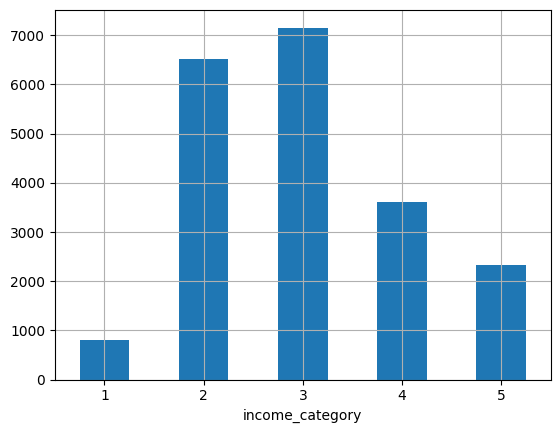

In [17]:
data['income_category'].value_counts().sort_index().plot.bar(rot=0, grid=True)

In [18]:
profile2 = ProfileReport(data, title="Profiling Report")
profile2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
profile2.to_file("data_profiling_report2.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 4. Spliting Data into Training & Testing  

In [20]:
train, test = train_test_split(data, test_size = 0.2, stratify=data['income_category'], random_state=124421)

In [21]:
train['income_category'].value_counts()/len(train['income_category'])
test['income_category'].value_counts()/len(test['income_category'])

income_category
3    0.350239
2    0.318855
4    0.176740
5    0.114340
1    0.039826
Name: count, dtype: float64

income_category
3    0.350135
2    0.318816
4    0.176658
5    0.114509
1    0.039883
Name: count, dtype: float64

## 5. Visulaize the Dataset 

<Axes: xlabel='longitude', ylabel='latitude'>

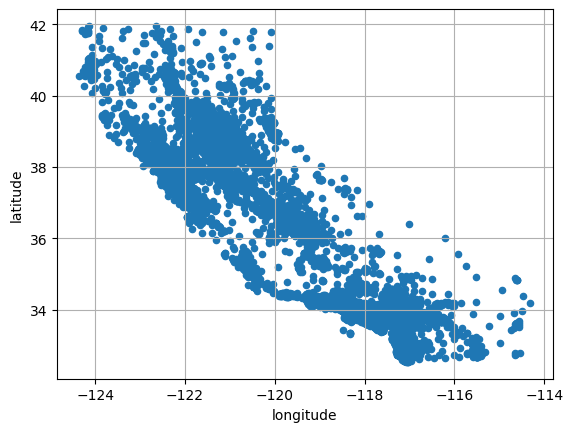

In [22]:
data.plot(kind='scatter',x='longitude', y='latitude',grid=True)

<Axes: xlabel='longitude', ylabel='latitude'>

<Axes: xlabel='longitude', ylabel='latitude'>

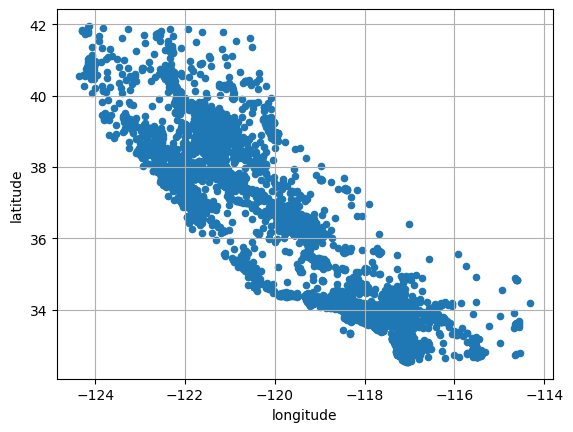

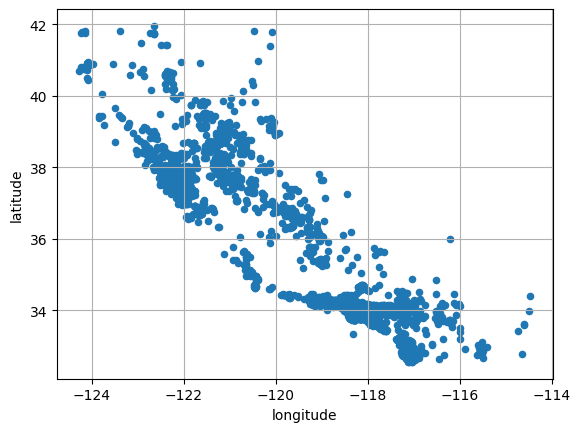

In [23]:
train.plot(kind='scatter',x='longitude', y='latitude',grid=True)
test.plot(kind='scatter',x='longitude', y='latitude',grid=True)

<Axes: xlabel='longitude', ylabel='latitude'>

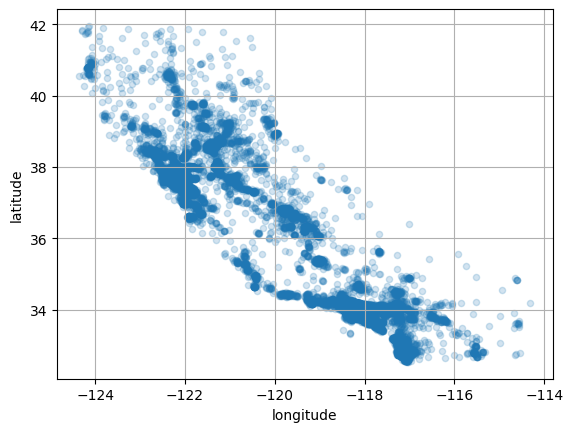

In [24]:
train.plot(kind='scatter',x='longitude', y='latitude',grid=True, alpha=0.2) # See High Density Data Points

<Axes: xlabel='longitude', ylabel='latitude'>

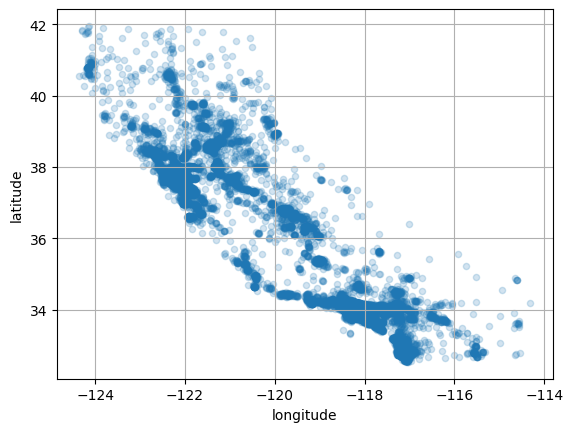

In [25]:
train.plot(kind='scatter',x='longitude', y='latitude',grid=True, alpha=0.2)

<Axes: xlabel='longitude', ylabel='latitude'>

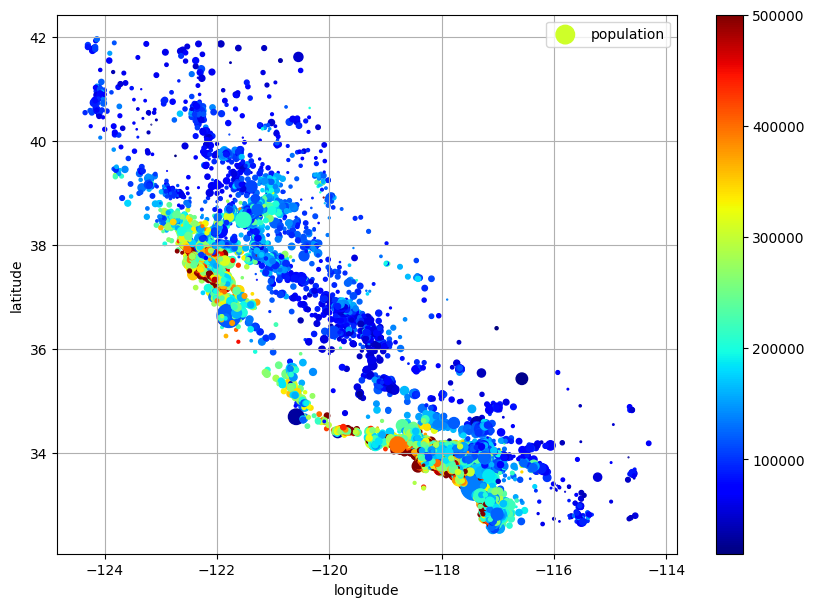

In [26]:
train.plot(kind='scatter',x='longitude', y='latitude',grid=True,
           s=train['population']/100, label='population', # s = Radius; use radius to visulatize population
           c=train['median_house_value'].to_list(), cmap='jet', colorbar=True, # c = colour; use color to visualize price
           legend=True, sharex=False, figsize=(10,7)
           )


<Axes: xlabel='longitude', ylabel='latitude'>

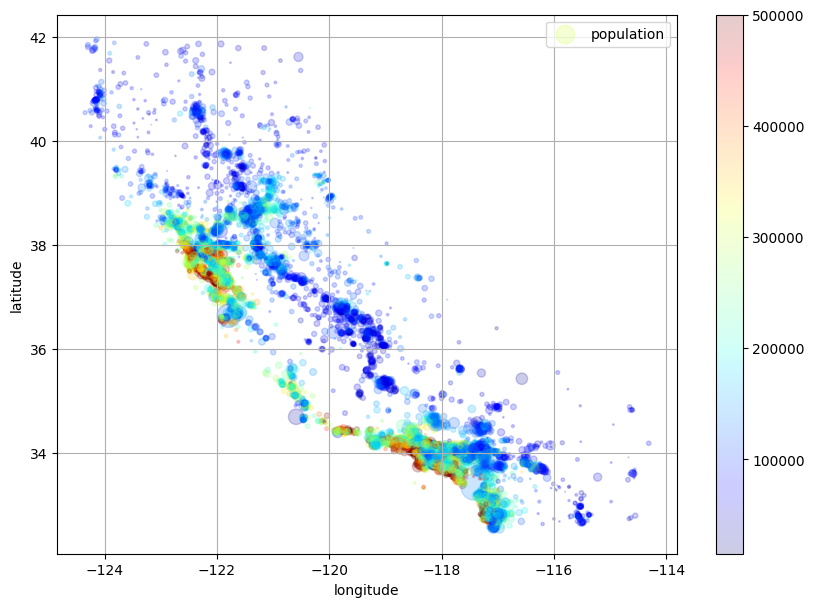

In [27]:
train.plot(kind='scatter',x='longitude', y='latitude',grid=True, alpha=0.2,
           s=train['population']/100, label='population', # s = Radius; use radius to visulatize population
           c=train['median_house_value'].to_list(), cmap='jet', colorbar=True, # c = colour; use color to visualize price
           legend=True, sharex=False, figsize=(10,7)
           )


In [28]:
profile = ProfileReport(train, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [29]:
corr = data.corr(numeric_only=True)
corr['median_house_value'].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688355
total_rooms           0.133294
housing_median_age    0.106432
households            0.064894
total_bedrooms        0.049686
population           -0.025300
longitude            -0.045398
latitude             -0.144638
Name: median_house_value, dtype: float64

<Figure size 1000x800 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Correlation Plot')

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 [Text(0.5, 0, 'longitude'),
  Text(1.5, 0, 'latitude'),
  Text(2.5, 0, 'housing_median_age'),
  Text(3.5, 0, 'total_rooms'),
  Text(4.5, 0, 'total_bedrooms'),
  Text(5.5, 0, 'population'),
  Text(6.5, 0, 'households'),
  Text(7.5, 0, 'median_income'),
  Text(8.5, 0, 'median_house_value'),
  Text(9.5, 0, 'income_category')])

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 [Text(0, 0.5, 'longitude'),
  Text(0, 1.5, 'latitude'),
  Text(0, 2.5, 'housing_median_age'),
  Text(0, 3.5, 'total_rooms'),
  Text(0, 4.5, 'total_bedrooms'),
  Text(0, 5.5, 'population'),
  Text(0, 6.5, 'households'),
  Text(0, 7.5, 'median_income'),
  Text(0, 8.5, 'median_house_value'),
  Text(0, 9.5, 'income_category')])

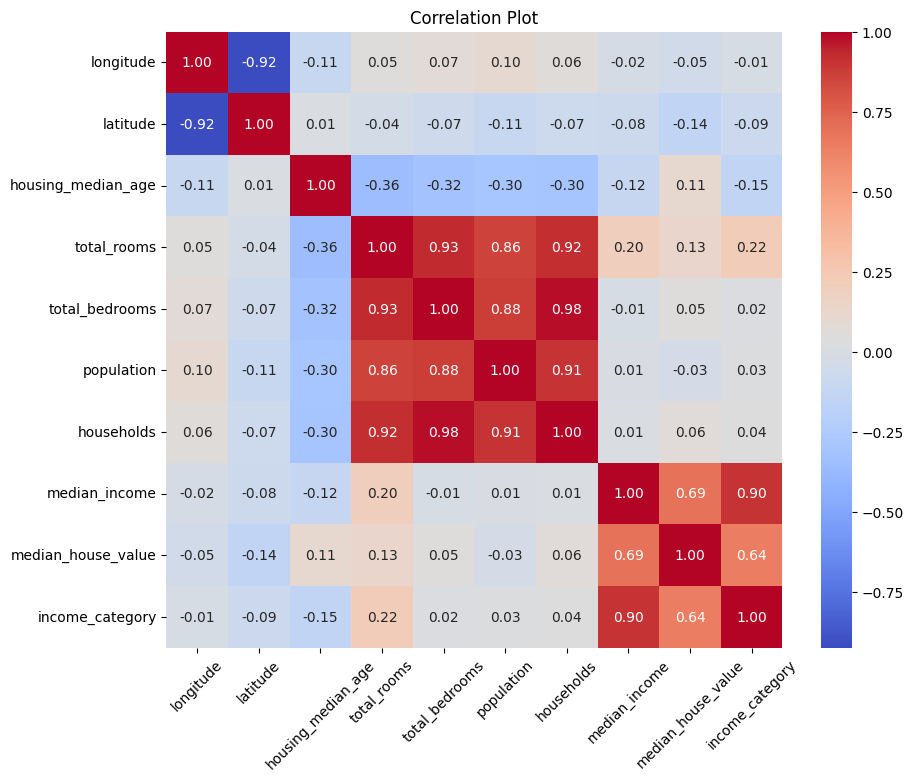

In [30]:
# Select numeric data and calculate correlation
correlation_matrix = data.select_dtypes(exclude='object').corr()

# Create a heatmap with annotations and a colormap
plt.figure(figsize=(10, 8))  # Larger figure size
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
plt.title('Correlation Plot')  # Set title
plt.xticks(rotation=45)  # Rotate x labels for better readability
plt.yticks(rotation=0)  # Ensure y labels are horizontal for better readability
plt.show()

<Figure size 1200x600 with 0 Axes>

C:\Users\Shubham\AppData\Local\Temp\ipykernel_20168\1703529593.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='ocean_proximity', y='median_house_value', data=train,


<Axes: xlabel='ocean_proximity', ylabel='median_house_value'>

Text(0.5, 1.0, 'Ocean Proximity Analysis for Median House Value')

Text(0.5, 0, 'Ocean Proximity')

Text(0, 0.5, 'Median House Value')

([0, 1, 2, 3, 4],
 [Text(0, 0, '<1H OCEAN'),
  Text(1, 0, 'INLAND'),
  Text(2, 0, 'NEAR BAY'),
  Text(3, 0, 'NEAR OCEAN'),
  Text(4, 0, 'ISLAND')])

(array([-100000.,       0.,  100000.,  200000.,  300000.,  400000.,
         500000.,  600000.,  700000.]),
 [Text(0, -100000.0, '−100000'),
  Text(0, 0.0, '0'),
  Text(0, 100000.0, '100000'),
  Text(0, 200000.0, '200000'),
  Text(0, 300000.0, '300000'),
  Text(0, 400000.0, '400000'),
  Text(0, 500000.0, '500000'),
  Text(0, 600000.0, '600000'),
  Text(0, 700000.0, '700000')])

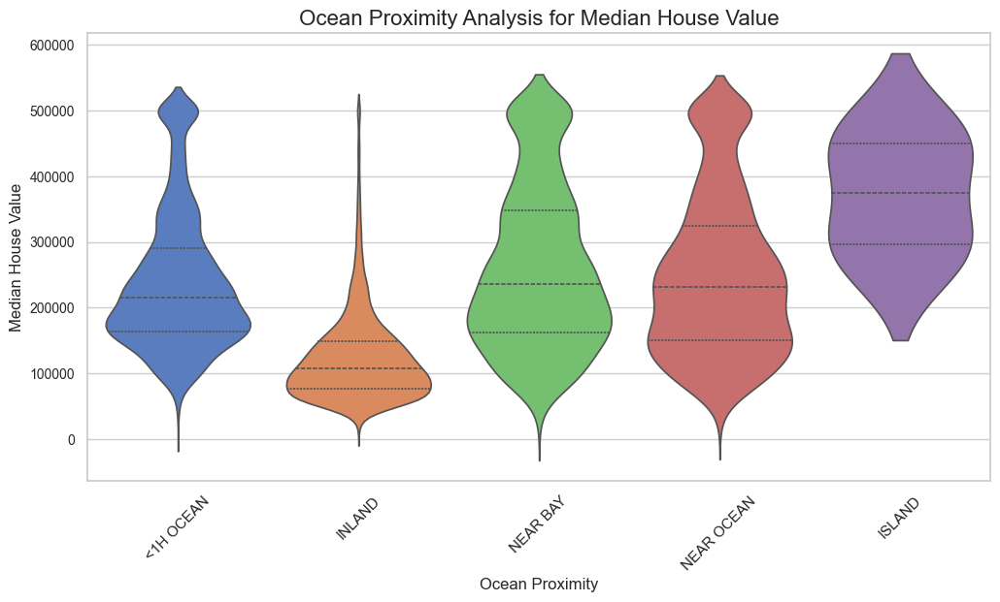

In [31]:
# Setting the aesthetic style of the plots
sns.set(style="whitegrid")

# Create a larger figure size for better visibility
plt.figure(figsize=(12, 6))

# Create a violin plot
sns.violinplot(x='ocean_proximity', y='median_house_value', data=train, 
               inner='quartile',  # Show quartiles within the violins for more detail
               palette='muted')  # Use a muted palette for aesthetic reasons

# Set titles and labels with larger fonts for better readability
plt.title('Ocean Proximity Analysis for Median House Value', fontsize=16)
plt.xlabel('Ocean Proximity', fontsize=12)
plt.ylabel('Median House Value', fontsize=12)

# Improve tick visibility
plt.xticks(rotation=45)  # Rotate x labels to prevent overlap
plt.yticks(fontsize=10)

In [32]:
data['rooms_per_house'] = data['total_rooms']/data['households']
data['bedrooms_ratio'] = data['total_bedrooms']/data['total_rooms']
data['people_per_house'] = data['population']/data['households']
corr_matrix = data.corr(numeric_only=True)
corr_matrix['median_house_value'].sort_values(ascending=False)

C:\Users\Shubham\AppData\Local\Temp\ipykernel_20168\959958492.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['rooms_per_house'] = data['total_rooms']/data['households']
C:\Users\Shubham\AppData\Local\Temp\ipykernel_20168\959958492.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['bedrooms_ratio'] = data['total_bedrooms']/data['total_rooms']
C:\Users\Shubham\AppData\Local\Temp\ipykernel_20168\959958492.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

median_house_value    1.000000
median_income         0.688355
rooms_per_house       0.151344
total_rooms           0.133294
housing_median_age    0.106432
households            0.064894
total_bedrooms        0.049686
people_per_house     -0.023639
population           -0.025300
longitude            -0.045398
latitude             -0.144638
bedrooms_ratio       -0.255880
Name: median_house_value, dtype: float64

<Figure size 1000x800 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Correlation Plot')

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5]),
 [Text(0.5, 0, 'longitude'),
  Text(1.5, 0, 'latitude'),
  Text(2.5, 0, 'housing_median_age'),
  Text(3.5, 0, 'total_rooms'),
  Text(4.5, 0, 'total_bedrooms'),
  Text(5.5, 0, 'population'),
  Text(6.5, 0, 'households'),
  Text(7.5, 0, 'median_income'),
  Text(8.5, 0, 'median_house_value'),
  Text(9.5, 0, 'income_category'),
  Text(10.5, 0, 'rooms_per_house'),
  Text(11.5, 0, 'bedrooms_ratio'),
  Text(12.5, 0, 'people_per_house')])

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5]),
 [Text(0, 0.5, 'longitude'),
  Text(0, 1.5, 'latitude'),
  Text(0, 2.5, 'housing_median_age'),
  Text(0, 3.5, 'total_rooms'),
  Text(0, 4.5, 'total_bedrooms'),
  Text(0, 5.5, 'population'),
  Text(0, 6.5, 'households'),
  Text(0, 7.5, 'median_income'),
  Text(0, 8.5, 'median_house_value'),
  Text(0, 9.5, 'income_category'),
  Text(0, 10.5, 'rooms_per_house'),
  Text(0, 11.5, 'bedrooms_ratio'),
  Text(0, 12.5, 'people_per_house')])

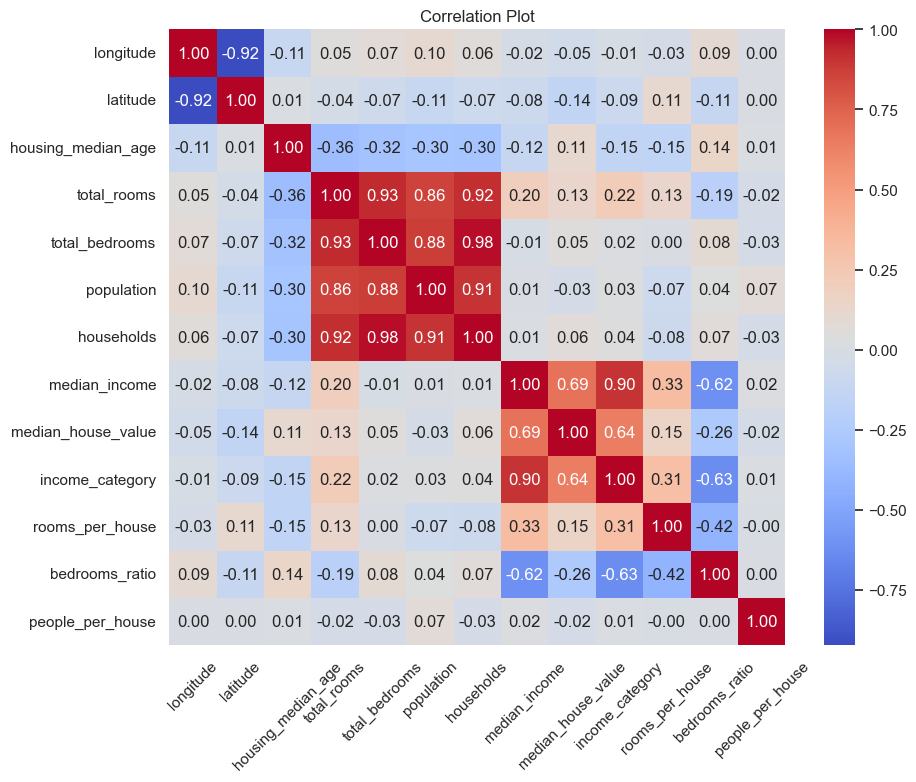

In [33]:
# Select numeric data and calculate correlation
correlation_matrix = data.select_dtypes(exclude='object').corr()

# Create a heatmap with annotations and a colormap
plt.figure(figsize=(10, 8))  # Larger figure size
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
plt.title('Correlation Plot')  # Set title
plt.xticks(rotation=45)  # Rotate x labels for better readability
plt.yticks(rotation=0)  # Ensure y labels are horizontal for better readability
plt.show()

# Preprocess Data for ML

In [34]:
train.select_dtypes(exclude='object').columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'income_category'],
      dtype='object')

In [35]:
train.select_dtypes(include='object').columns

Index(['ocean_proximity'], dtype='object')

In [36]:
data.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity', 'income_category',
       'rooms_per_house', 'bedrooms_ratio', 'people_per_house'],
      dtype='object')

In [37]:
class Preprocessor(BaseEstimator, TransformerMixin):
    # Train our Custom Preprocessors
    numerical_columns = ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']
    categorical_columns = ['ocean_proximity']

    def fit(self, X, y=None):

        # Create and fit Simple Imputer - Fill Null Values
        self.imputer = SimpleImputer(strategy='median')
        self.imputer.fit(X[self.numerical_columns])


        # Create and fit Standard Scaler - Make the values Scaler
        self.scaler = StandardScaler()
        self.scaler.fit(X[self.numerical_columns])


        # Create and fir One Hot Encoder - Make Object Class worthy of ML
        self.onehot = OneHotEncoder(handle_unknown='ignore')
        self.onehot.fit(X[self.categorical_columns])

        return self


    def transform(self, X):
        
        # Apply Simple Imputer 
        imputed_col = self.imputer.transform(X[self.numerical_columns])
        onehot_col = self.onehot.transform(X[self.categorical_columns])

        # Copy the Dataframe
        transformed_data = X.copy()

        # Apply Transformed Columns
        transformed_data[self.numerical_columns] = imputed_col
        transformed_data[self.numerical_columns] = self.scaler.transform(transformed_data[self.numerical_columns])

        # Drop Existing Categorical Columns & Replace with One Hot Equivalent
        transformed_data = transformed_data.drop(self.categorical_columns, axis=1)
        transformed_data[self.onehot.get_feature_names_out()] = onehot_col.toarray().astype(int)

        return transformed_data

In [38]:
'''
df = pd.read_csv('housing.csv')
df['income_category'] = pd.cut(df['median_income'],
                                 bins = [0., 1.5, 3.0, 4.5, 6., np.inf],
                                 labels=[1,2,3,4,5]
                                 )
'''

"\ndf = pd.read_csv('housing.csv')\ndf['income_category'] = pd.cut(df['median_income'],\n                                 bins = [0., 1.5, 3.0, 4.5, 6., np.inf],\n                                 labels=[1,2,3,4,5]\n                                 )\n"

In [39]:
#train, test = train_test_split(df, test_size=0.3, stratify=df['income_category'], random_state=14052024)

In [40]:
preproc = Preprocessor()

In [41]:
X_train = train.drop('median_house_value', axis=1)
y_train = train['median_house_value']

In [42]:
X_test = test.drop('median_house_value', axis=1)
y_test = test['median_house_value']

In [43]:
preproc.fit(X_train)
preprocessed_data = preproc.transform(X_train)
preprocessed_data.head()

Preprocessor()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,income_category,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
17581,0.814021,-0.905617,-0.682253,0.071363,-0.311087,-0.158950,-0.238606,1.177288,5,1,0,0,0,0
20509,1.248018,-1.280379,-1.552867,-0.502109,-0.768086,-0.653247,-0.708946,1.940411,5,1,0,0,0,0
9838,0.639425,-0.802558,0.030069,-0.185631,-0.337685,-0.249144,-0.387414,-0.038648,3,1,0,0,0,0
10851,0.759148,-0.498064,0.584096,-0.527204,-0.671366,-0.462249,-0.631885,-0.005467,3,0,1,0,0,0
13249,0.524690,-0.558962,-0.207372,-0.836247,-0.934926,-0.807992,-0.902928,0.718847,4,1,0,0,0,0


In [44]:
# Gradient Boosting is not executing.
pipelines = {
    'ridge': make_pipeline(Preprocessor(), Ridge()),
    'rf': make_pipeline(Preprocessor(), RandomForestClassifier()),
    #'gb': make_pipeline(Preprocessor(), GradientBoostingClassifier()),
    'xg': make_pipeline(Preprocessor(), XGBRegressor()),
}

In [45]:
grid = {
    'ridge': {'ridge__alpha': [0.05, 0.25, 0.5, 1.0]},
    'rf': {
        'randomforestclassifier__n_estimators': [10, 50, 100],
        'randomforestclassifier__max_depth': [1, 2, 3, None]
    },
    '''
    'gb': {
        'gradientboostingclassifier__n_estimators': [10, 50, 100],
        'gradientboostingclassifier__max_depth': [1, 2, 3, None]
    },
    '''
    'xg': {
        'xgbregressor__n_estimators': [10, 50, 100],
        'xgbregressor__max_depth': [1, 2, 3, None],
        'xgbregressor__enable_categorical': [True]
    }
}

In [46]:
##Ridge??

In [47]:
fit_models = {}
per_models = {}
class_report = {}

for algorithm, pipeline in pipelines.items():
    metrics = {}
    class_report_temp = {}
    try:
        print(f'Fitting model: {algorithm}')
        model = GridSearchCV(pipeline, grid[algorithm], n_jobs=-1, cv=10, scoring='r2' if 'regressor' in algorithm else 'accuracy')
        model.fit(X_train, y_train)
        fit_models[algorithm] = model

        # Predict and evaluate
        y_pred = model.predict(X_test)
        metrics = {
            'accuracy': accuracy_score(y_test, y_pred),
            'precision': precision_score(y_test, y_pred, average='weighted'),
            'recall': recall_score(y_test, y_pred, average='weighted'),
            'f1_score': f1_score(y_test, y_pred, average='weighted'),
            'mean_squared_error': mean_squared_error(y_test, y_pred),
            'mean_absolute_error': mean_absolute_error(y_test, y_pred),
            'root_mean_squared_error': np.sqrt(mean_squared_error(y_test, y_pred))
            }
        
        class_report_temp = {
            'classification_report': classification_report(y_test, y_pred, output_dict=True)
            }

        per_models[algorithm] = metrics
        class_report[algorithm] = class_report_temp
        print(f"Metrics for {algorithm}: {metrics}")
        print(f"Classification Report for {algorithm}: {classification_report(y_test, y_pred, output_dict=True)}")

    except Exception as e:
        print(f'Model {algorithm} has an error: {e}')


Fitting model: ridge


c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_search.py:1051: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan]
  warnings.warn(


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor', Preprocessor()),
                                       ('ridge', Ridge())]),
             n_jobs=-1, param_grid={'ridge__alpha': [0.05, 0.25, 0.5, 1.0]},
             scoring='accuracy')

c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  warnings.warn(


Model ridge has an error: Classification metrics can't handle a mix of multiclass and continuous targets
Fitting model: rf


c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
26 fits failed out of a total of 120.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Shubha

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor', Preprocessor()),
                                       ('randomforestclassifier',
                                        RandomForestClassifier())]),
             n_jobs=-1,
             param_grid={'randomforestclassifier__max_depth': [1, 2, 3, None],
                         'randomforestclassifier__n_estimators': [10, 50, 100]},
             scoring='accuracy')

Metrics for rf: {'accuracy': 0.04526547589919256, 'precision': 0.002370617419271677, 'recall': 0.04526547589919256, 'f1_score': 0.004190787509137477, 'mean_squared_error': 98252096931.26205, 'mean_absolute_error': 291204.127232689, 'root_mean_squared_error': 313451.90529212303}
Classification Report for rf: {'25000.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '32500.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 2.0}, '32900.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '40000.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '42100.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 2.0}, '42500.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '43000.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '43300.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, '45100.0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0

c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Shubham\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modi

In [48]:
'''for i in pipelines:
    model_fit(i)
    '''
# Convert classification reports to DataFrames for better readability
for algorithm, metrics in per_models.items():
    if 'classification_report' in metrics:
        report_df = pd.DataFrame(metrics['classification_report']).transpose()
        print(f"\nClassification Report for {algorithm}:\n", report_df)

# Convert per_models to DataFrame for easier display of non-classification metrics
metrics_df = pd.DataFrame({
    algorithm: {k: v for k, v in metrics.items() if k != 'classification_report'}
    for algorithm, metrics in per_models.items()
}).transpose()

print("\nOverall Metrics:")
print(metrics_df)

'for i in pipelines:\n    model_fit(i)\n    '


Overall Metrics:
    accuracy  precision    recall  f1_score  mean_squared_error  \
rf  0.045265   0.002371  0.045265  0.004191        9.825210e+10   

    mean_absolute_error  root_mean_squared_error  
rf        291204.127233            313451.905292  


In [49]:
per_models

{'rf': {'accuracy': 0.04526547589919256,
  'precision': 0.002370617419271677,
  'recall': 0.04526547589919256,
  'f1_score': 0.004190787509137477,
  'mean_squared_error': 98252096931.26205,
  'mean_absolute_error': 291204.127232689,
  'root_mean_squared_error': 313451.90529212303}}

In [50]:
# Print the best performance by each model
for algorithm, metrics in per_models.items():
    print(f"\nBest Performance Metrics for {algorithm}:")
    print(f"Accuracy: {metrics.get('accuracy', 'N/A'):.4f}")
    print(f"Precision: {metrics.get('precision', 'N/A'):.4f}")
    print(f"Recall: {metrics.get('recall', 'N/A'):.4f}")
    print(f"F1 Score: {metrics.get('f1_score', 'N/A'):.4f}")
    if 'r2_score' in metrics:
        print(f"R2 Score: {metrics['r2_score']:.4f}")
    print(f"Mean Squared Error: {metrics['mean_squared_error']:.4f}")
    print(f"Mean Absolute Error: {metrics['mean_absolute_error']:.4f}")
    print(f"Root Mean Squared Error: {metrics['root_mean_squared_error']:.4f}")


Best Performance Metrics for rf:
Accuracy: 0.0453
Precision: 0.0024
Recall: 0.0453
F1 Score: 0.0042
Mean Squared Error: 98252096931.2621
Mean Absolute Error: 291204.1272
Root Mean Squared Error: 313451.9053


In [51]:
metrics['accuracy']

0.04526547589919256

## Ridge

In [52]:
#ridge = GridSearchCV(pipelines['ridge'], grid['ridge'], n_jobs=-1, cv=10, scoring='r2')

In [53]:
#ridge.fit(X_train, y_train)

In [54]:
#y_train_ridge=ridge.predict(X_train)
#(y_train_ridge-y_train).mean()

In [55]:
#y_ridge=ridge.predict(X_test)
#(y_ridge-y_test).mean()

## Random Forest

In [56]:
#rf = GridSearchCV(pipelines['rf'], grid['rf'], n_jobs=-1, cv=10, scoring='r2')

In [57]:
#rf.fit(X_train, y_train)

In [58]:
#y_train_rf=rf.predict(X_train)
#(y_train_rf-y_train).mean()


In [59]:
#y_rf=rf.predict(X_test)
#(y_rf-y_test).mean()

## Gradient Boosting

In [60]:
#gb = GridSearchCV(pipelines['gb'], grid['gb'], n_jobs=-1, cv=10, scoring='r2')

In [61]:
#gb.fit(X_train, y_train)


In [62]:
#y_train_gb=gb.predict(X_train)
#(y_train_gb-y_train).mean()


In [63]:
#y_gb=gb.predict(X_test)
#(y_gb-y_test).mean()

## XGB Regressor

In [64]:
#xg = GridSearchCV(pipelines['xg'], grid['xg'], n_jobs=-1, cv=10, scoring='r2')


In [65]:
#xg.fit(X_train, y_train)

In [66]:
#y_train_xg=xg.predict(X_train)
#(y_train_xg-y_train).mean()


In [67]:
#y_xg=xg.predict(X_test)
#(y_xg-y_test).mean()